# Brief House Prices

Etape 1 : Recuperer la base de donnée train.csv

Etape 2 : Comprendre la signification de chaque colonne : https://www.kaggle.com/c/house-prices-advanced-regression-techniques/data

Etape 3 : Créer un notebook avec un titre et importer train.csv dans un dataframe

Etape 4 : Réaliser une analyse exploratoire (moyenne, ecart-type, mediane, identifier les valeurs manquantes, correlations, data visualisation) ==> Privilegier la qualité de l'analyse plutôt que la quantité de cellule executé.

Etape 5 : Faites une regression lineaire avec une feature. Choisir une feature qui n'a pas besoin d'être transformée).

Etape 6 : Faites une regression lineaire avec Stats model et interpreter les résultats.

Etape 7 : Faites une regression lineaire avec sklearn et interpreter les resultats : https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LinearRegression.html#sklearn.linear_model.LinearRegression

Etape 8 (Objectif) : Réaliser une prediction avec sklearn. Exemple : Prédire le prix d'un logement qui fait 58m2.

Etape 9 Optionnel level 1 : Separer les données d'entrainement et données de test (test.csv) : https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.train_test_split.html

Etape 10 : Revenir à l'étape 7 et faire un .fit(X_train) avec les données d'entrainement et un .score(X_test) sur les données de test. (cf sklearn).

Etape 11 : Comparer la difference de score entre l'entrainement avec de la fuite de donnée ( .fit(X_train, et un .score(y_train) ) et sans fuite de donnée (.fit(X_train) .score(y_test) interpreter.

Etape 12 Optionnel Level 2 : Ajouter une feature supplémentaire (qui vous semble pertinante) à votre model pour essayer d'ameliorer les performances de votre model. Vous aurez probablement besoin d'utiliser cet outil de sklearn par exemple : https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.OneHotEncoder.html

Etape 13 Optionnel Level 3: Structurer votre code avec par exemple :

Un fichier data.py > avec une methode .get_data()
Un fichier model.py > avec une methode .train()
Un fichier preprocessing.py > avec une methode .cleaning() et .preprocessing_'colum_name'()

## Import des packages

In [1]:
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns

## Import du dataset avec pandas et visualisation du dataframe

In [2]:
df = pd.read_csv('train.csv')
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


## Analyse exploratoire

- On regarde ce que contient notre dataframe, le nombre de colonnes et de lignes, le type des colonnes...

In [3]:
df.shape

(1460, 81)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

Notre dataframe contient pas mal de données numériques (int et float) et des données de type object qui dans le cas présent sont des string


- On fait un .describe() pour visualiser les moyenne(mean), ecart-type(std), median(50%quartile), min, max... des colonnes numériques.

In [14]:
#pd.set_option('display.max_columns', None)
df.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,...,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,...,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,...,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,...,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,...,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,...,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


- On regarde le nombre de valeurs nulles par colonnes

In [5]:
#pd.set_option('display.max_rows', None)
df.isnull().sum()

Id                 0
MSSubClass         0
MSZoning           0
LotFrontage      259
LotArea            0
                ... 
MoSold             0
YrSold             0
SaleType           0
SaleCondition      0
SalePrice          0
Length: 81, dtype: int64

- On drop les colonnes contennant des valeurs nulles dans la mesure où elles ne nous semblent pas pertinantes

In [23]:
df.dropna(axis=1)

,Id,MSSubClass,MSZoning,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,...,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,...,0,0,0,0,0,2,2008,WD,Normal,208500
1,2,20,RL,9600,Pave,Reg,Lvl,AllPub,FR2,Gtl,...,0,0,0,0,0,5,2007,WD,Normal,181500
2,3,60,RL,11250,Pave,IR1,Lvl,AllPub,Inside,Gtl,...,0,0,0,0,0,9,2008,WD,Normal,223500
3,4,70,RL,9550,Pave,IR1,Lvl,AllPub,Corner,Gtl,...,272,0,0,0,0,2,2006,WD,Abnorml,140000
4,5,60,RL,14260,Pave,IR1,Lvl,AllPub,FR2,Gtl,...,0,0,0,0,0,12,2008,WD,Normal,250000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,1456,60,RL,7917,Pave,Reg,Lvl,AllPub,Inside,Gtl,...,0,0,0,0,0,8,2007,WD,Normal,175000
1456,1457,20,RL,13175,Pave,Reg,Lvl,AllPub,Inside,Gtl,...,0,0,0,0,0,2,2010,WD,Normal,210000
1457,1458,70,RL,9042,Pave,Reg,Lvl,AllPub,Inside,Gtl,...,0,0,0,0,2500,5,2010,WD,Normal,266500
1458,1459,20,RL,9717,Pave,Reg,Lvl,AllPub,Inside,Gtl,...,112,0,0,0,0,4,2010,WD,Normal,142125


- On regarde si on a des lignes en double

In [7]:
df.duplicated().sum()

0

### A ce stade nous avons décidé de ne selectionner qu'un certain nombre de colonnes qui nous semblaient pertinentes

In [8]:
df_final = df[['YrSold','BedroomAbvGr','CentralAir','Heating','HeatingQC','OverallQual','OverallCond','YearBuilt','YearRemodAdd','BldgType','Condition1','Condition2','LotArea','MSZoning','SalePrice']]
df_final.head()

,YrSold,BedroomAbvGr,CentralAir,Heating,HeatingQC,OverallQual,OverallCond,YearBuilt,YearRemodAdd,BldgType,Condition1,Condition2,LotArea,MSZoning,SalePrice
0,2008,3,Y,GasA,Ex,7,5,2003,2003,1Fam,Norm,Norm,8450,RL,208500
1,2007,3,Y,GasA,Ex,6,8,1976,1976,1Fam,Feedr,Norm,9600,RL,181500
2,2008,3,Y,GasA,Ex,7,5,2001,2002,1Fam,Norm,Norm,11250,RL,223500
3,2006,3,Y,GasA,Gd,7,5,1915,1970,1Fam,Norm,Norm,9550,RL,140000
4,2008,4,Y,GasA,Ex,8,5,2000,2000,1Fam,Norm,Norm,14260,RL,250000


In [9]:
df_final.shape

(1460, 15)

In [10]:
df_final.dtypes

YrSold           int64
BedroomAbvGr     int64
CentralAir      object
Heating         object
HeatingQC       object
OverallQual      int64
OverallCond      int64
YearBuilt        int64
YearRemodAdd     int64
BldgType        object
Condition1      object
Condition2      object
LotArea          int64
MSZoning        object
SalePrice        int64
dtype: object

In [11]:
df_final.describe()

,YrSold,BedroomAbvGr,OverallQual,OverallCond,YearBuilt,YearRemodAdd,LotArea,SalePrice
count,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,2007.815753,2.866438,6.099315,5.575342,1971.267808,1984.865753,10516.828082,180921.195890
std,1.328095,0.815778,1.382997,1.112799,30.202904,20.645407,9981.264932,79442.502883
min,2006.000000,0.000000,1.000000,1.000000,1872.000000,1950.000000,1300.000000,34900.000000
25%,2007.000000,2.000000,5.000000,5.000000,1954.000000,1967.000000,7553.500000,129975.000000
50%,2008.000000,3.000000,6.000000,5.000000,1973.000000,1994.000000,9478.500000,163000.000000
75%,2009.000000,3.000000,7.000000,6.000000,2000.000000,2004.000000,11601.500000,214000.000000
max,2010.000000,8.000000,10.000000,9.000000,2010.000000,2010.000000,215245.000000,755000.000000


- On fait la matrice de correlation afin de regarder les possibles correlations entre nos colonnes et le SalePrice qui est notre target.

<AxesSubplot:>

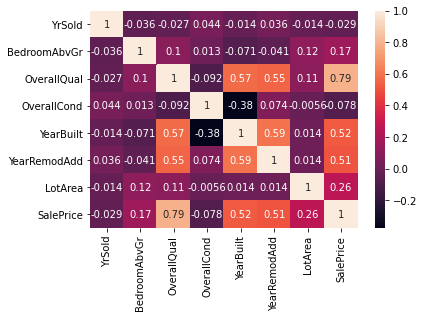

In [21]:
sns.heatmap(df_final.corr(), annot=True)

Le résultat n'est pas très concluant, peu de colonnes ont des scores supérieur à 0.5 au final, donc pour voir si nous n'avions pas écarté des colonnes qui pourraient être interessantes, nous avons refait une heatmap avec notre dataframe de base nettoyé.

<AxesSubplot:>

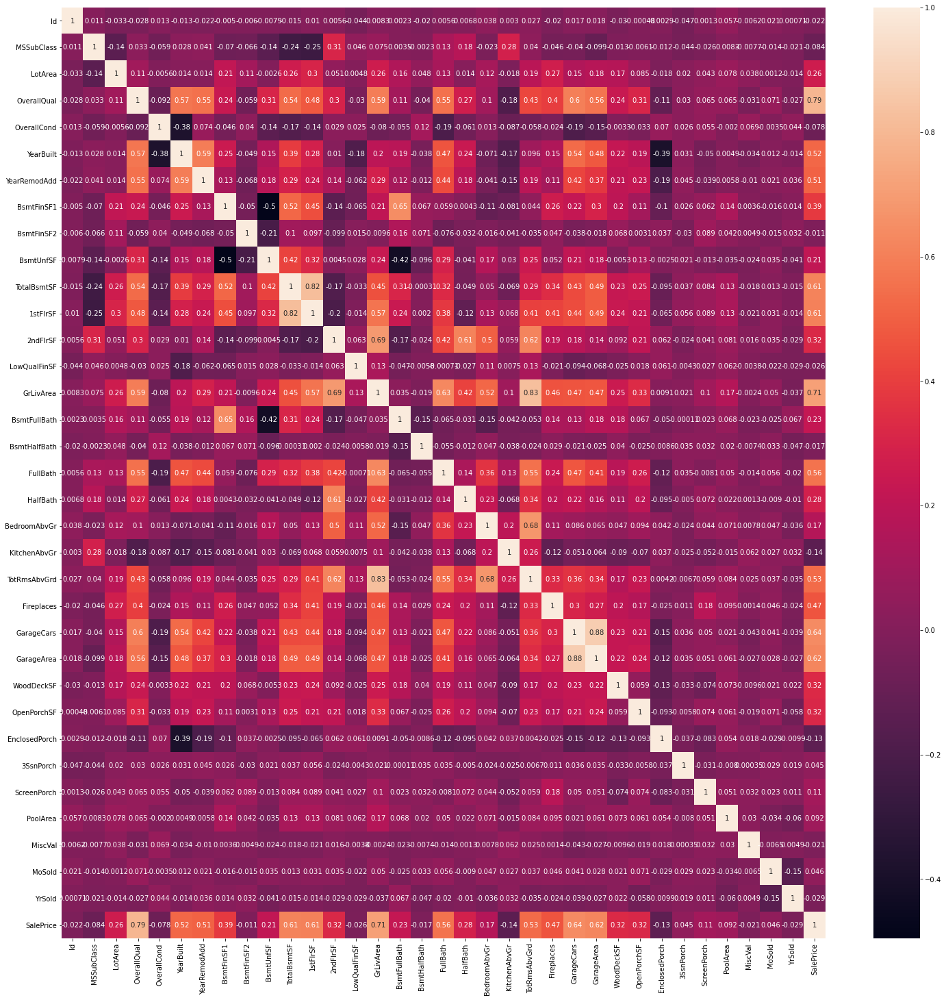

In [24]:
fig, ax = plt.subplots(figsize=(25,25))
sns.heatmap(df.corr(), annot=True)

### A la suite de ces heatmaps nous avons décidé de faire un nouveau dataframe et de ne garder que les colonnes avec un score de correlation supérieur à 0.50.

In [81]:
df_clean_two = df[["OverallQual", "YearBuilt", "YearRemodAdd", "TotalBsmtSF", "1stFlrSF", "GrLivArea", "FullBath", "TotRmsAbvGrd", "GarageCars", "GarageArea", "SalePrice"]]
df_clean_two

,OverallQual,YearBuilt,YearRemodAdd,TotalBsmtSF,1stFlrSF,GrLivArea,FullBath,TotRmsAbvGrd,GarageCars,GarageArea,SalePrice
0,7,2003,2003,856,856,1710,2,8,2,548,208500
1,6,1976,1976,1262,1262,1262,2,6,2,460,181500
2,7,2001,2002,920,920,1786,2,6,2,608,223500
3,7,1915,1970,756,961,1717,1,7,3,642,140000
4,8,2000,2000,1145,1145,2198,2,9,3,836,250000
...,...,...,...,...,...,...,...,...,...,...,...
1455,6,1999,2000,953,953,1647,2,7,2,460,175000
1456,6,1978,1988,1542,2073,2073,2,7,2,500,210000
1457,7,1941,2006,1152,1188,2340,2,9,1,252,266500
1458,5,1950,1996,1078,1078,1078,1,5,1,240,142125


- On fait un pair plot afin de visualiser la distribution de nos variables (diagonale) et les variables les une par rapport aux autres, deux à deux.

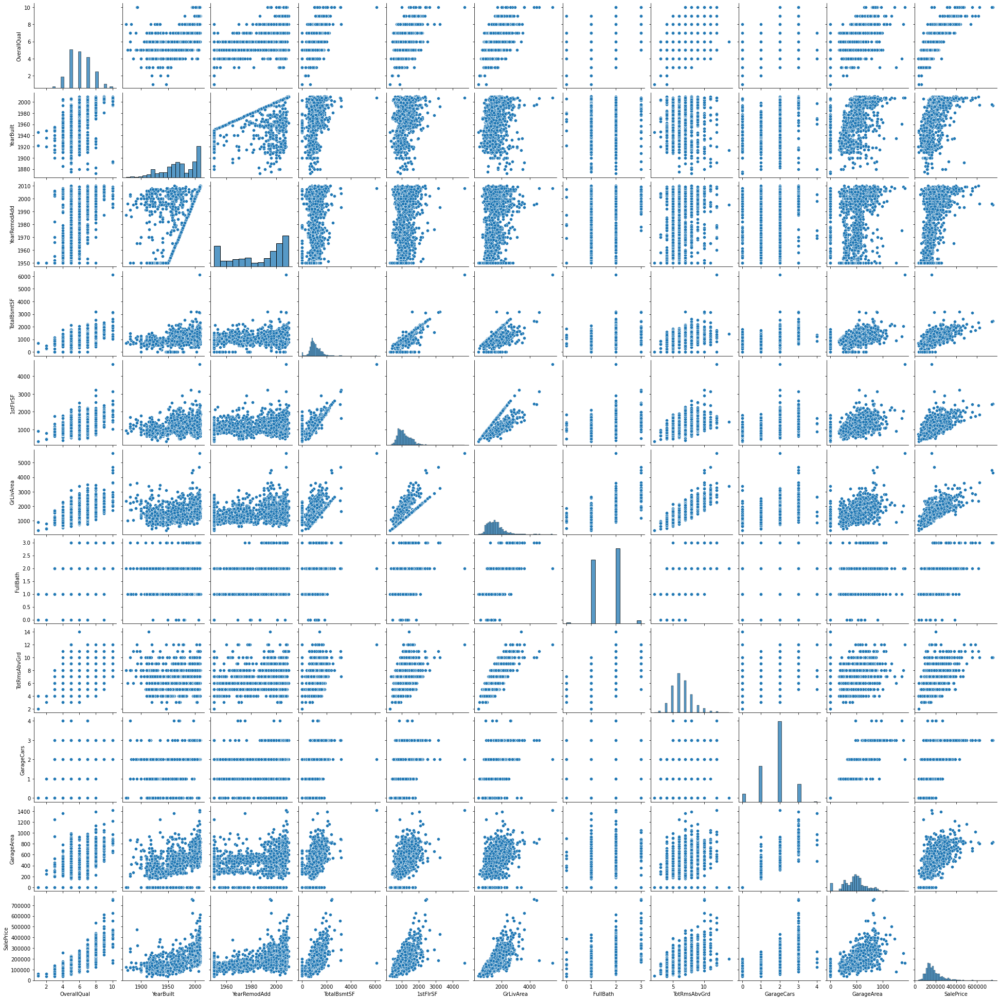

In [27]:
sns.pairplot(df_clean_two)

### On remarque plusieurs choses : 
 - Certaines colonnes (une majorité), ont des distibitons qui resemblent à une loi normale mais un peu excentrée vers la gauche (pourrait être amélioré avec une normalisation des données...)
 - On remarque plusieurs colonnes qui peuvent être qualifiées de variables catégorielles : FullBath, GarageCars et moins clairement OverallQual et TotRmsAbvGrd.
 - On remarque également des tendances sur les scatter plots par rapport au SalePrice, qui font penser à une regression linéaire. Par exemple, le prix de vente SalePrice augmente en correlation avec la surface habitable GrLivArea.

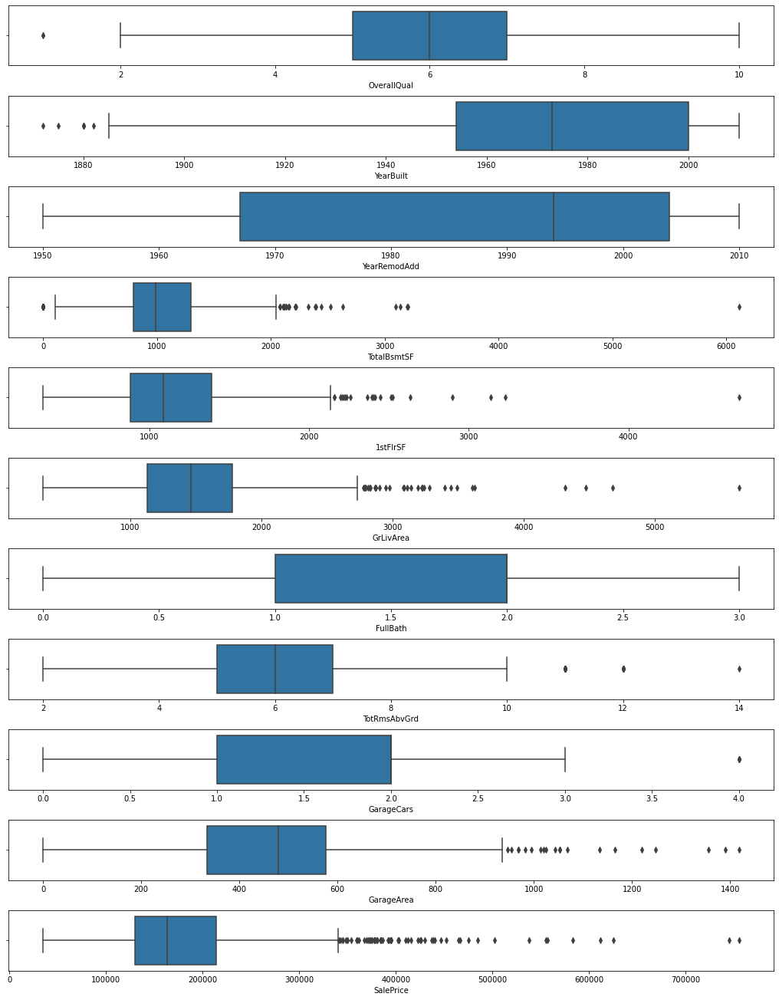

In [46]:
features_list = ["OverallQual", "YearBuilt", "YearRemodAdd", "TotalBsmtSF", "1stFlrSF", "GrLivArea", "FullBath", "TotRmsAbvGrd", "GarageCars", "GarageArea", "SalePrice"]
fig, axes = plt.subplots(nrows=len(features_list), ncols=1, figsize = (14, 18), constrained_layout=True)
for i, feature in enumerate(features_list): 
    sns.boxplot(data = df, x=feature, ax=axes[i])

### On remarque plusieurs choses : 
 - GarageCars et FullBath, les deux features catégorielles n'ont pas de mediane sur le boxplot... ?
 - On peut voir qu'il y a beaucoup d'outliers qu'il faudrait regarder de plus près afin de voir si on peux les supprimer ou pas. (Nous avons laissé cette étape de coté par manque de temps)
 - On vois aussi que les échelles des axes sont très différentes, il serait peut être utile de faire un scaling afin de ramemner les features à des valeurs comparables entre elles...
 - On voit aussi que les surfaces ne sont pas en m2 (GarageArea, GrLivArea...), nous allons les convertir afin d'avoir une unité de mesure plus compréhensible.

In [82]:
#Conversion des colonnes représentant des surfaces en m2
df_clean_two[["TotalBsmtSF", "1stFlrSF", "GrLivArea","GarageArea"]] = df_clean_two[["TotalBsmtSF", "1stFlrSF", "GrLivArea","GarageArea"]].apply(lambda x: x / 10.7639).round(2)
df_clean_two

/home/juliecharrier/anaconda3/lib/python3.7/site-packages/pandas/core/frame.py:3069: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


,OverallQual,YearBuilt,YearRemodAdd,TotalBsmtSF,1stFlrSF,GrLivArea,FullBath,TotRmsAbvGrd,GarageCars,GarageArea,SalePrice
0,7,2003,2003,79.53,79.53,158.86,2,8,2,50.91,208500
1,6,1976,1976,117.24,117.24,117.24,2,6,2,42.74,181500
2,7,2001,2002,85.47,85.47,165.92,2,6,2,56.49,223500
3,7,1915,1970,70.23,89.28,159.51,1,7,3,59.64,140000
4,8,2000,2000,106.37,106.37,204.20,2,9,3,77.67,250000
...,...,...,...,...,...,...,...,...,...,...,...
1455,6,1999,2000,88.54,88.54,153.01,2,7,2,42.74,175000
1456,6,1978,1988,143.26,192.59,192.59,2,7,2,46.45,210000
1457,7,1941,2006,107.02,110.37,217.39,2,9,1,23.41,266500
1458,5,1950,1996,100.15,100.15,100.15,1,5,1,22.30,142125


## Nous allons maintenant regarder plus en détail les deux features ayant le meilleur score.

Text(0, 0.5, 'Prix de vente en $')

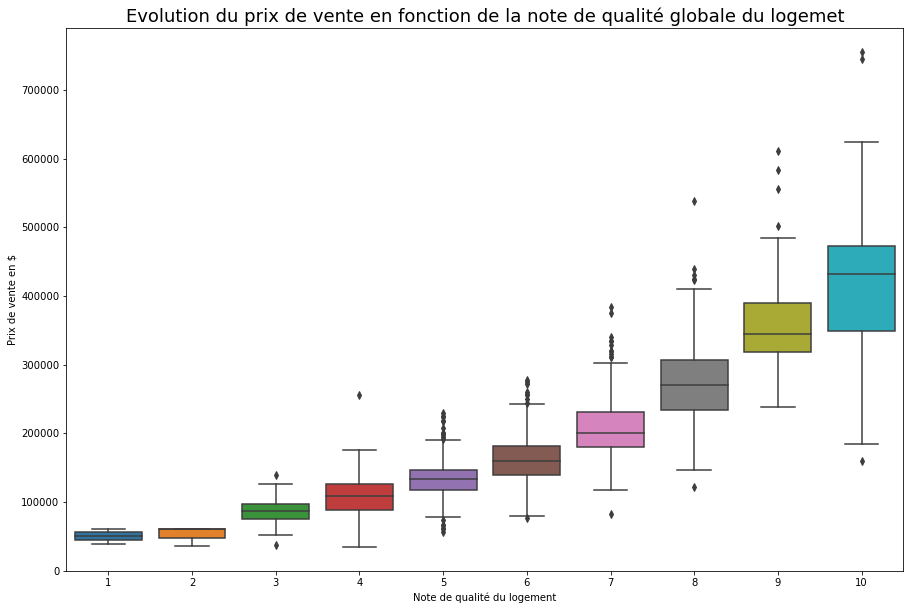

In [98]:
fig, ax = plt.subplots(figsize=(15,10))
sns.boxplot(x="OverallQual", y="SalePrice", data=df_clean_two)
ax.set_title('Evolution du prix de vente en fonction de la note de qualité globale du logemet', fontsize=18)
ax.set_xlabel('Note de qualité du logement')
ax.set_ylabel('Prix de vente en $')

On peut voir que plus les notes sont élévées, plus le prix de vente augmente.
Mais cette feature etant de type plutôt catégorielle, nous ne baserons pas notre régression sur celle-ci.

### Nous allons plutôt choisir la surface habitable

Text(0, 0.5, 'Prix de vente en $')

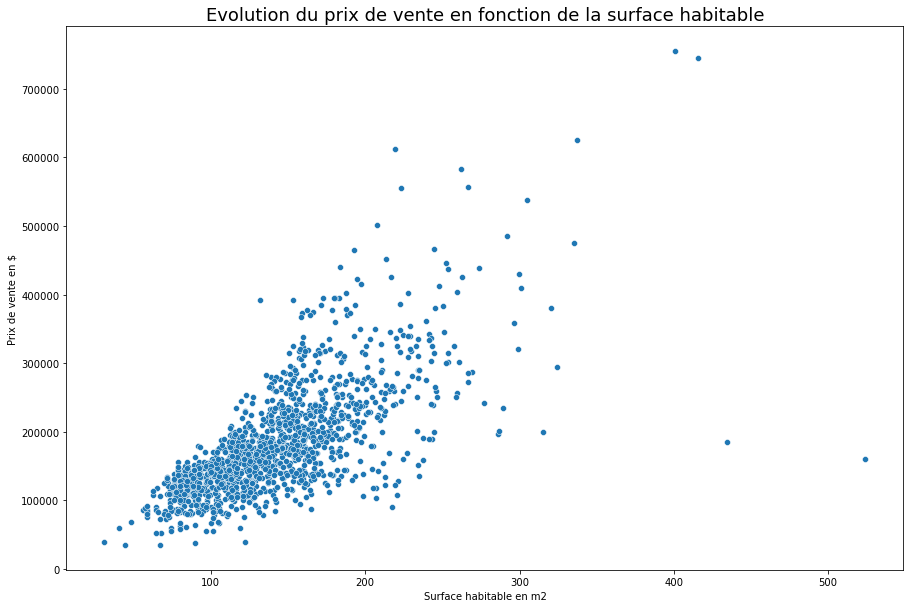

In [85]:
fig, ax = plt.subplots(figsize=(15,10))
sns.scatterplot(x="GrLivArea", y="SalePrice", data=df_clean_two)
ax.set_title('Evolution du prix de vente en fonction de la surface habitable', fontsize=18)
ax.set_xlabel('Surface habitable en m2')
ax.set_ylabel('Prix de vente en $')

On voit bien que plus la surface augment plus le prix de vente augmente. 

## On trace la droite de régression linéaire : 

Text(0, 0.5, 'Prix de vente en $')

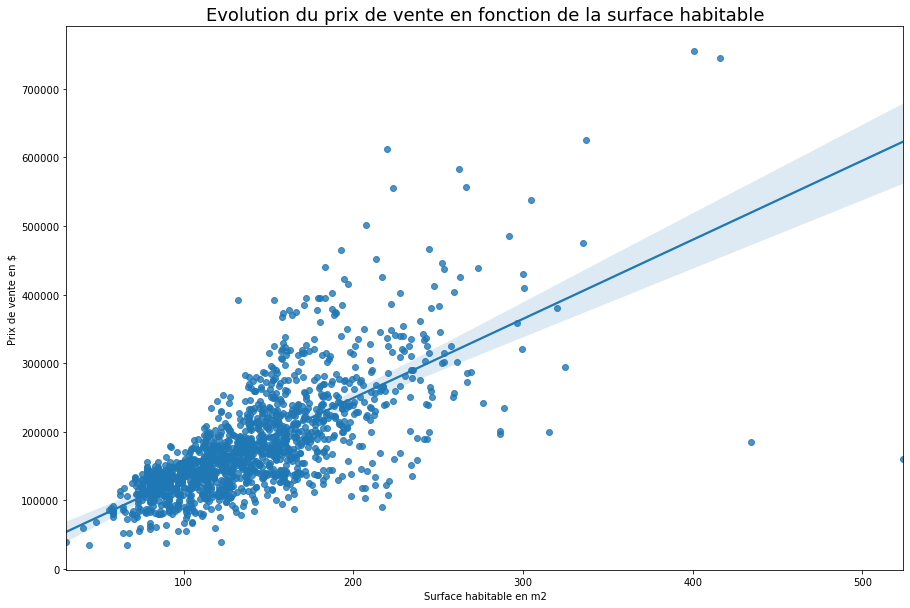

In [86]:
fig, ax = plt.subplots(figsize=(15,10))
sns.regplot(x='GrLivArea', y='SalePrice', data=df_clean_two);
ax.set_title('Evolution du prix de vente en fonction de la surface habitable', fontsize=18)
ax.set_xlabel('Surface habitable en m2')
ax.set_ylabel('Prix de vente en $')

## Regression linaire avec Statsmodels

- import des modules et entrainement du modèle


In [97]:
import statsmodels.formula.api as smf
from statsmodels.formula.api import ols
results = smf.ols('SalePrice ~ GrLivArea', data=df_clean_two).fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              SalePrice   R-squared:                       0.502
Model:                            OLS   Adj. R-squared:                  0.502
Method:                 Least Squares   F-statistic:                     1471.
Date:                Thu, 20 May 2021   Prob (F-statistic):          4.51e-223
Time:                        16:05:40   Log-Likelihood:                -18035.
No. Observations:                1460   AIC:                         3.607e+04
Df Residuals:                    1458   BIC:                         3.608e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   1.857e+04   4480.755      4.144      0.000    9779.421    2.74e+04
GrLivArea   1153.1409     30.070     38.348      0.000    1094.155    1212.126
==============================================================================
Omnibus:                      261.166   Durbin-Watson:                   2.025
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             3432.391
Skew:                           0.410   Prob(JB):                         0.00
Kurtosis:                      10.467   Cond. No.                         455.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

### Interprétation :
- On obtient un R2 de 0.502, ce qui signifie que notre modèle n'est pas très fiable, il n'explique que 50% des résultats
- Le Prob (F-statistic) est quant à lui très proche de 0.
- La P-value pour cette feature est de 0, on peut donc rejeter l'hypothèse nulle, cette feature est significative.
- L'intercept est positif, on en conclu que la droite de regression est croissante. Et que la feature et la target augmentent conjointenment.

## Régression Linéaire avec ScikitLearn

- import du modèle et entrainement

In [89]:
from  sklearn.linear_model import LinearRegression
X_train = df_clean_two[['GrLivArea']]
y_train = df_clean_two['SalePrice']

model = LinearRegression()
model = model.fit(X_train,y_train)
model.score(X_train,y_train)

0.5021491861311453

In [96]:
display(model.coef_)
display(model.intercept_)

array([1153.14092126])

18568.834856440546

On retrouve le même R2 que précédemment et les même intercept et coefficient qu'avec Statsmodels

## Prédiction du prix d'un 58 m2


In [92]:
x = 58
model.predict([[x]])

array([85451.00828979])

Pour une surface de 58m2, le modèle nous prédit un prix de 85451 $. Ce qui malgré tout semble cohérant avec le graphique.